Одним из методов анализа изображений является бинаризация изображения -  классификация пикселей одноканального изображения в градациях серого на два класса – «объект» и «фон». Каждый пиксель такого изображения будет иметь только два значения: чистый черный или чистый белый. Существуют различные алгоритмы бинаризации: в данной работе будет реализовано несколько из них, а также проверена их работа на тестовоном наборе изображений. 

#### 1. Алгоритм Оцу

Данный алгоритм заключается в нахождении глобального порога для всех пикселей изображения: пиксели с интенсивностью меньше, чем значение порога будут отнесены к классу "фон", больше - к классу "объект".

 Для нахождения порогового числа используется исчерпывающий метод, и эти пиксели разделяются на две категории, так что внутриклассовая дисперсия яркости двух типов пикселей является наименьшей. Внутриклассовая дисперсия относится к взвешенной сумме дисперсий двух типов пикселей, где вес относится к отношению количества таких пикселей к количеству пикселей во всем изображении:

$$ 
 \sigma_{\omega}^2 = \omega_{1}(t)\sigma_{1}^2(t) + \omega_{2}(t)\sigma_{2}^2(t)
$$

где веса $\omega_{i}$ - это вероятности двух классов, разделённых порогом t, а $\sigma_{i}^2$ — дисперсия этих классов. Было показано, что минимизация дисперсии внутри класса равносильна максимизации дисперсии между классами.

In [62]:
from PIL import Image
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from typing import Tuple
import os
from scipy.signal import convolve2d as cnv2d

In [63]:
def otsu(image):
    assert image.dtype == np.uint8 and len(image.shape) <= 2
    thrs = np.arange(np.min(image), np.max(image), 1)
    max_thr = 0
    pix = image.flatten()
    min_var = float('inf')
    for i in thrs:
        pix_less, pix_more = pix[pix < i], pix[pix >= i]     
        prob_1, prob_2 = len(pix_less) / len(pix), len(pix_more) / len(pix)
        var_1, var_2 = np.var(pix_less), np.var(pix_more)
        var_tot = prob_1 * var_1 + prob_2 * var_2 
        if var_tot < min_var:
            min_var = var_tot
            max_thr = i
    res = image.copy()
    for i in res:
        for j in range(len(i)):
            if i[j] > max_thr:
                i[j] = 255
            else:
                i[j] = 0
    return max_thr, res.astype(np.uint8)

Пример работы алгоритма Оцу:

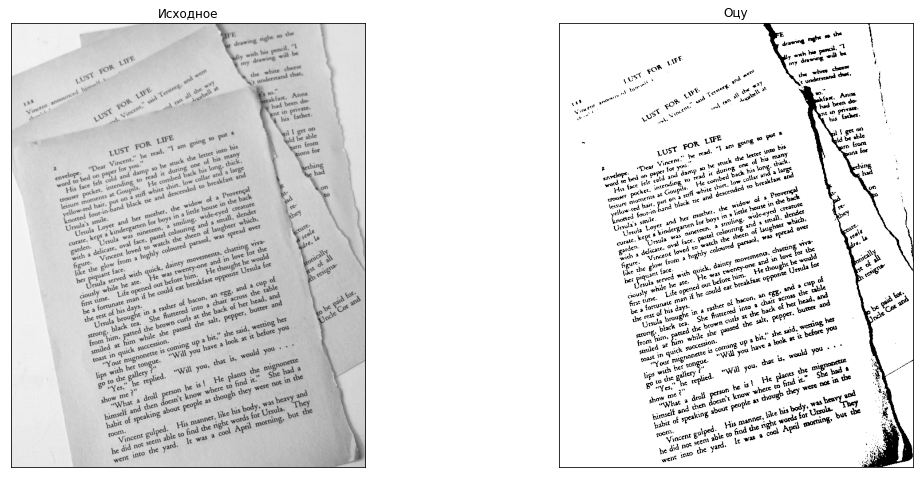

Порог:  149




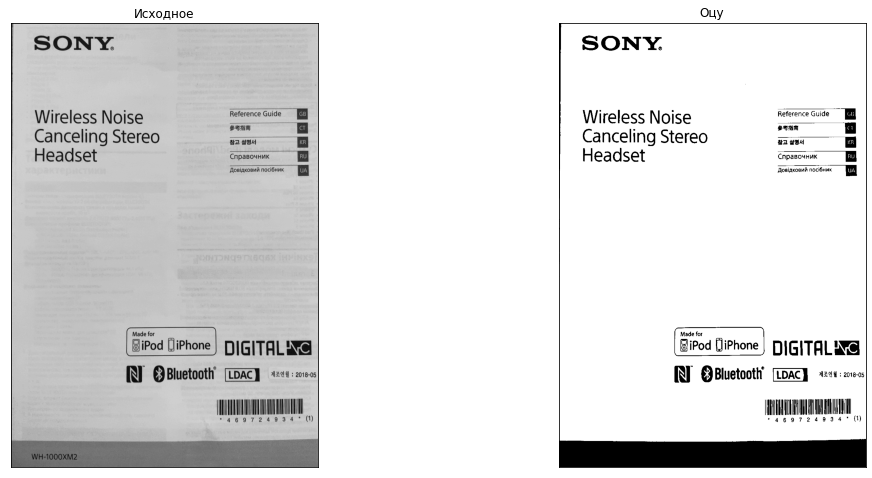

Порог:  105


In [283]:
img = Image.open('dataset/0.jpg')
img = np.array(img.convert("L"))

fig = plt.figure(figsize=(18,18))
ax_source = fig.add_subplot(221, title='Исходное')
ax_source.axes.xaxis.set_ticks([])
ax_source.axes.yaxis.set_ticks([])
ax_source.imshow(img, cmap='Greys_r')

th_o, img_o = otsu(img)
ax_otsu = fig.add_subplot(222, title='Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o, cmap='Greys_r')

plt.show()
print('Порог: ', th_o)
print()
print()

img2 = Image.open('dataset/9.png')
img2 = np.array(img2.convert("L"))

fig = plt.figure(figsize=(18,18))
ax_source = fig.add_subplot(223, title='Исходное')
ax_source.axes.xaxis.set_ticks([])
ax_source.axes.yaxis.set_ticks([])
ax_source.imshow(img2, cmap='Greys_r')

th_o2, img_o2 = otsu(img2)
ax_otsu = fig.add_subplot(224, title='Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o2, cmap='Greys_r')
plt.show()
print('Порог: ', th_o2)

#### 2. Модифицированный алгоритм Оцу

В случае, когда веса классов объекта и фона изначально не равны, можно модифицировать алгоритм Оцу: для каждого тестируемого порога параметры нормальных распределений в результирующем бинарном изображении оцениваются методом максимального правдоподобия.

In [64]:
def otsu_modification(image):
    assert image.dtype == np.uint8 and len(image.shape) <= 2
    thrs = np.arange(np.min(image) + 0.2, np.max(image) + 0.2, 1)
    max_thr = 0
    pix = image.flatten()
    max_var = float('-inf')
    for i in thrs:
        pix_less, pix_more = pix[pix < i], pix[pix >= i]     
        prob_1, prob_2 = len(pix_less) / len(pix), len(pix_more) / len(pix)
        var_1, var_2 = np.var(pix_less), np.var(pix_more)
        var_tot = np.log2(prob_1) * prob_1 - np.log2(prob_1 * var_1 + prob_2 * var_2) + np.log2(prob_2) * prob_2
        if var_tot > max_var:
            max_var = var_tot
            max_thr = i
    res = image.copy()
    for i in res:
        for j in range(len(i)):
            if i[j] > max_thr:
                i[j] = 255
            else:
                i[j] = 0
    return max_thr, res.astype(np.uint8)

Пример работы модифицированного алгоритма Оцу:

/Users/akmal/opt/anaconda3/envs/image_analysis_hse/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3723: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/akmal/opt/anaconda3/envs/image_analysis_hse/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/Users/akmal/opt/anaconda3/envs/image_analysis_hse/lib/python3.8/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


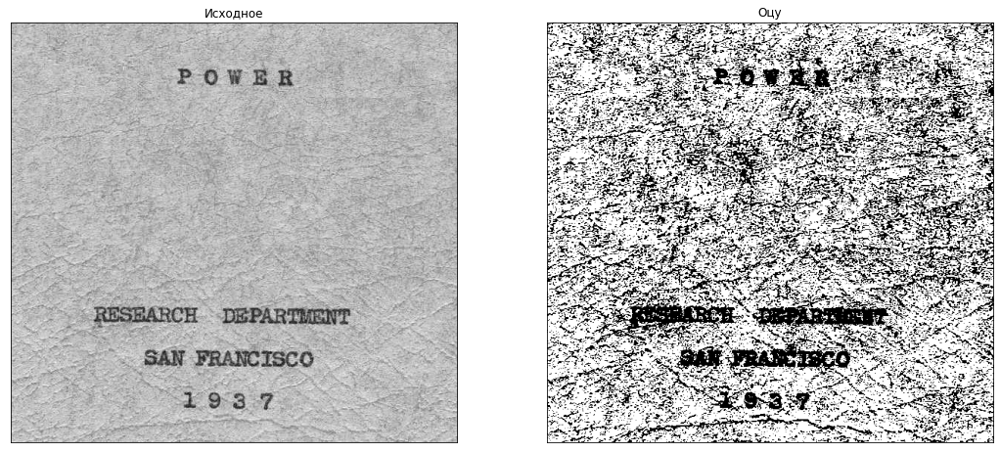

Порог:  114



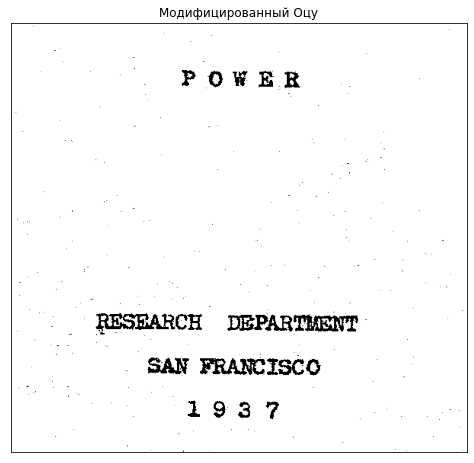

Порог:  90.2


In [6]:
img = Image.open('dataset/6.png')
img = np.array(img.convert("L"))

fig = plt.figure(figsize=(18,18))
ax_source = fig.add_subplot(221, title='Исходное')
ax_source.axes.xaxis.set_ticks([])
ax_source.axes.yaxis.set_ticks([])
ax_source.imshow(img, cmap='Greys_r')

th_o, img_o = otsu(img)
ax_otsu = fig.add_subplot(222, title='Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o, cmap='Greys_r')
plt.show()
print('Порог: ', th_o)
print()

fig = plt.figure(figsize=(18,18))
th_o2, img_o2 = otsu_modification(img)
ax_otsu = fig.add_subplot(223, title='Модифицированный Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o2, cmap='Greys_r')
plt.show()
print('Порог: ', th_o2)

#### 3.  Алгоритм Ниблэка

Алгоритм Ниблэка является локальным пороговым методом, применяющийся к бинаризации изображений с неоднородным фоном, в частности для распознавания текста. Вместо расчета одного глобального порога для всего изображения, несколько порогов рассчитываются для каждого пикселя по формуле, учитывающей среднее и стандартное отклонение локальной окрестности (определяемой окном с центром вокруг пикселя):


$$ 
 T(x,y) = \mu(x,y) + \alpha\sigma(x,y)
$$

где веса $\mu$ - среднее по некоторому окну (области) на изображении вокруг точки (x,y), $\sigma$ – стандартный разброс яркости пикселей в окне, а $\alpha$ – параметр алгоритма.

In [65]:
def niblack(image, window, alpha):
    assert image.dtype == np.uint8 and len(image.shape) <= 2
    window_avg = np.ones((window, window)) / pow(window, 2)
    image = image.astype(float)
    cnv_avg = cnv2d(image, window_avg, mode='same', boundary='symm')
    cnv_avg_sq = cnv2d(image ** 2, window_avg, mode='same', boundary='symm')
    std = np.sqrt(cnv_avg_sq - cnv_avg ** 2)
    thr_func = cnv_avg - alpha * std
    res = image.copy()
    assert len(thr_func) == len(res)
    for i in range(len(res)):
        for j in range(len(res[i])):
            if res[i][j] > thr_func[i][j]:
                res[i][j] = 255
            else:
                res[i][j] = 0
    return res.astype(np.uint8)

Пример работы алгоритма Ниблэка (размер окна - 50, параметр алгоритма - 1.3):

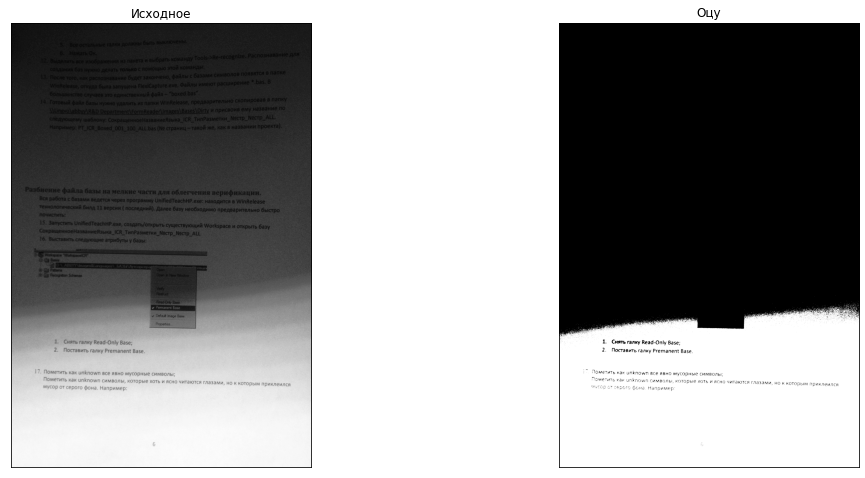

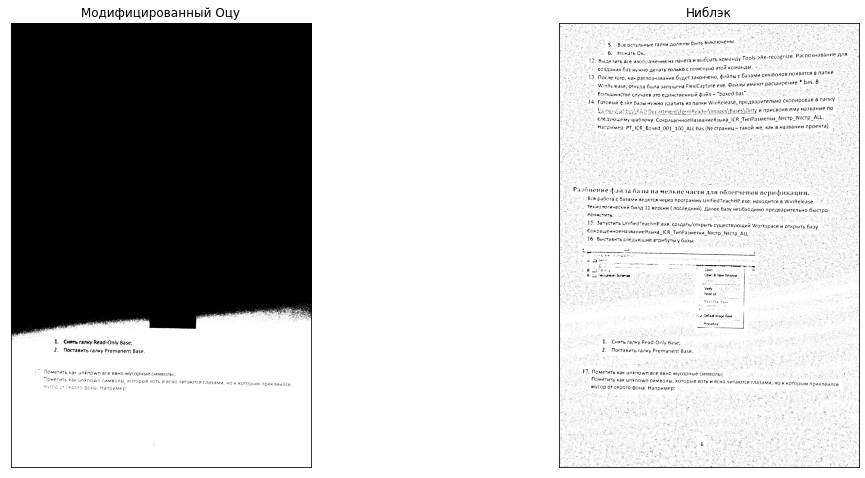

В масштабе:


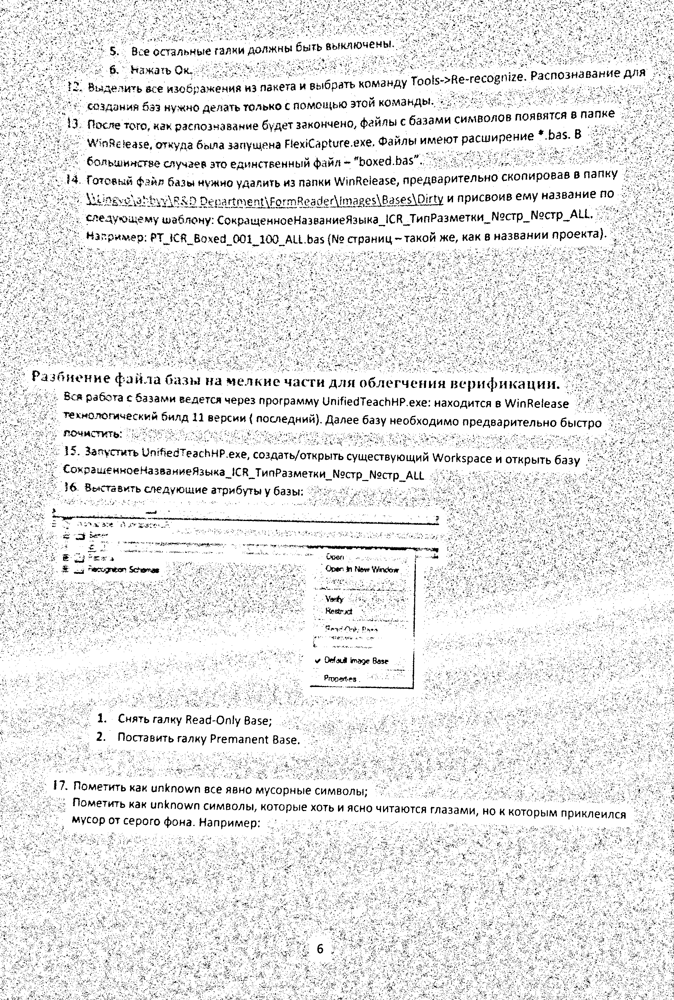

In [287]:
img = Image.open('dataset/24.jpg')
img = np.array(img.convert("L"))

fig = plt.figure(figsize=(18,18))
ax_source = fig.add_subplot(221, title='Исходное')
ax_source.axes.xaxis.set_ticks([])
ax_source.axes.yaxis.set_ticks([])
ax_source.imshow(img, cmap='Greys_r')

th_o, img_o = otsu(img)
ax_otsu = fig.add_subplot(222, title='Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o, cmap='Greys_r')
plt.show()
print()

fig = plt.figure(figsize=(18,18))
th_o2, img_o2 = otsu_modification(img)
ax_otsu = fig.add_subplot(223, title='Модифицированный Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o2, cmap='Greys_r')

img_nibl = niblack(img, 50, 1.3)
ax_otsu = fig.add_subplot(224, title='Ниблэк')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_nibl, cmap='Greys_r')
plt.show()

print('В масштабе:')
img = Image.open('dataset/24.jpg')
img = np.array(img.convert("L"))
im1 = niblack(img, 50, 1.3)
display(Image.fromarray(im1))

In [10]:
from PIL import Image
img = Image.open('dataset/24.jpg')
img = np.array(img.convert("L"))

print(img.shape)

(2952, 1992)


#### Модифицированный алгоритм Ниблэка

In [66]:
def niblack_modification(image, window, alpha, std_min):
    assert image.dtype == np.uint8 and len(image.shape) <= 2
    image = image.astype(float)
    mean_win, std_win = np.zeros_like(image), np.zeros_like(image)
    thr = np.empty_like(image)
    
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            to_edge = window // 2
            flag = False
            while not flag:
                top = max(0, i - to_edge)
                bottom = i + to_edge + 1
                left = max(0, j - to_edge)
                right = j + to_edge + 1
                win_pix = image[top:bottom, left:right]
                mean = np.mean(win_pix)
                std = np.std(win_pix)
                if std > std_min:
                    thr[i, j] = mean - alpha * std
                    mean_win[i, j] = mean
                    std_win[i, j] = std
                    flag = True
                else:
                    to_edge *= 2
                    if (min(j + to_edge, image.shape[1]) - max(0, j - to_edge) > image.shape[1] and 
                        min(i + to_edge, image.shape[0]) - max(0, i - to_edge) > image.shape[0]):
                        raise Exception("Process stopped, since window size > image size") 
    
    res = image.copy()
    for i in range(len(res)):
        for j in range(len(res[i])):
            if res[i][j] > thr[i][j]:
                res[i][j] = 255
            else:
                res[i][j] = 0
    return res.astype(np.uint8)

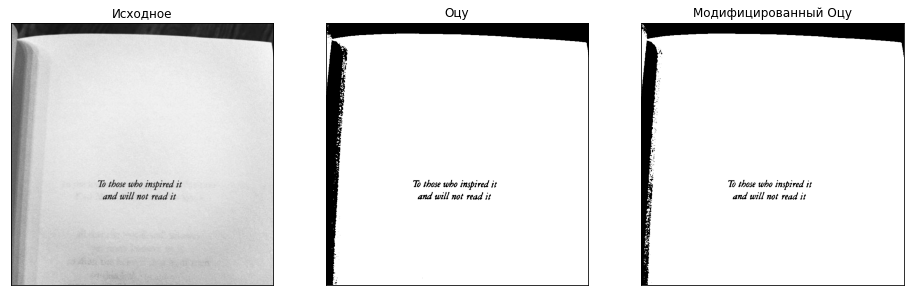

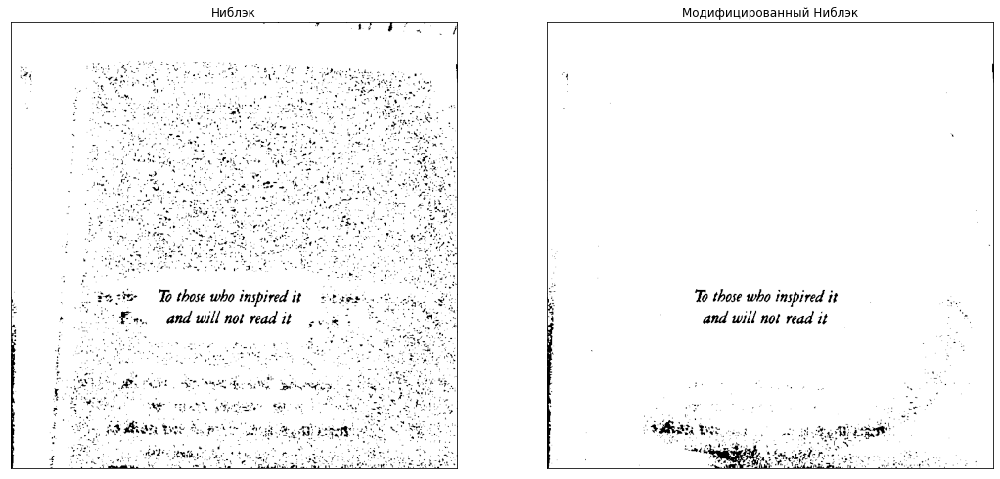

In [59]:
img = Image.open('dataset/28.jpg')
img = np.array(img.convert("L"))

fig = plt.figure(figsize=(16,16))
ax_source = fig.add_subplot(131, title='Исходное')
ax_source.axes.xaxis.set_ticks([])
ax_source.axes.yaxis.set_ticks([])
ax_source.imshow(img, cmap='Greys_r')

# fig = plt.figure(figsize=(14,14))
th_o, img_o = otsu(img)
ax_otsu = fig.add_subplot(132, title='Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o, cmap='Greys_r')
# plt.show()
# print()

# fig = plt.figure(figsize=(14,14))
th_o2, img_o2 = otsu_modification(img)
ax_otsu = fig.add_subplot(133, title='Модифицированный Оцу')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_o2, cmap='Greys_r')

plt.show()

fig = plt.figure(figsize=(18,18))
img_nibl = niblack(img, 60, 1.3)
ax_otsu = fig.add_subplot(121, title='Ниблэк')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_nibl, cmap='Greys_r')


# fig = plt.figure(figsize=(18,18))
img_nibl_mod = niblack_modification(img, 60, 1.3, 8.0)
ax_otsu = fig.add_subplot(122, title='Модифицированный Ниблэк')
ax_otsu.axes.xaxis.set_ticks([])
ax_otsu.axes.yaxis.set_ticks([])    
ax_otsu.imshow(img_nibl_mod, cmap='Greys_r')

plt.show()

# from timeit import default_timer as timer
# start = timer()


# img = Image.open('dataset/0.jpg')
# img = np.array(img.convert("L"))
# im1 = niblack_modification(img, 60, 1.3, 8.0)
# display(Image.fromarray(im1))


# end = timer()
# print('time:', end - start)
# print('\nМодифицированный Ниблэк:')

In [84]:
img = Image.open('dataset/0.jpg')
img = np.array(img.convert("L"))
img_nibl_mod = niblack_modification(img, 50, 1.1, 20.0)

display(Image.fromarray(img_nibl_mod))
# fig = plt.figure(figsize=(16,16))
# ax_otsu = fig.add_subplot(111, title='Модифицированный Ниблэк')
# ax_otsu.axes.xaxis.set_ticks([])
# ax_otsu.axes.yaxis.set_ticks([])
# # plt.title('Модифицированный Ниблэк')
# ax_otsu.imshow(img_nibl_mod, cmap='Greys_r')

# plt.show()

KeyboardInterrupt: 

#### 4. Применение алгоритмов

Выбор одного из приведенных выше алгоритмов для бинаризации изображения будет зависить от обрабатываемого изображения. Например, если распределения яркости фона и объекта нормальны, имеют одинаковую дисперсию и число пикселей объекта и фона равны между собой, то метод Оцу будет оптимальным в смысле максимального правдоподобия. Однако, в случае когда веса классов объекта и фона изначально не равны, более правильным выбором будет модификация метода Оцу.
В свою очередь, алгоритм Ниблэка можно применять к бинаризации изображений с неоднородным фоном (к примеру, при затемнении каких-либо областей фотографии), в частности для распознавания текста. Однако данный метод более ресурсозатратный. 

#### 5. Бинаризация изображений из тестового набора реализованными алгоритмами

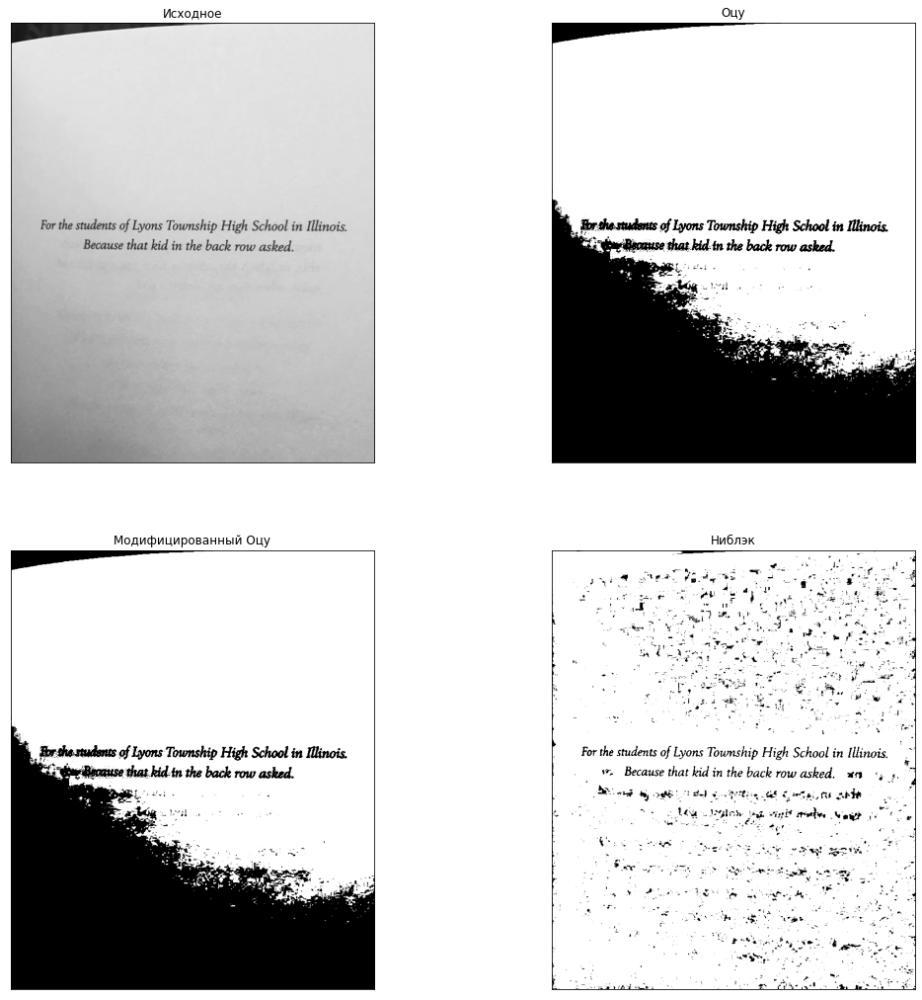

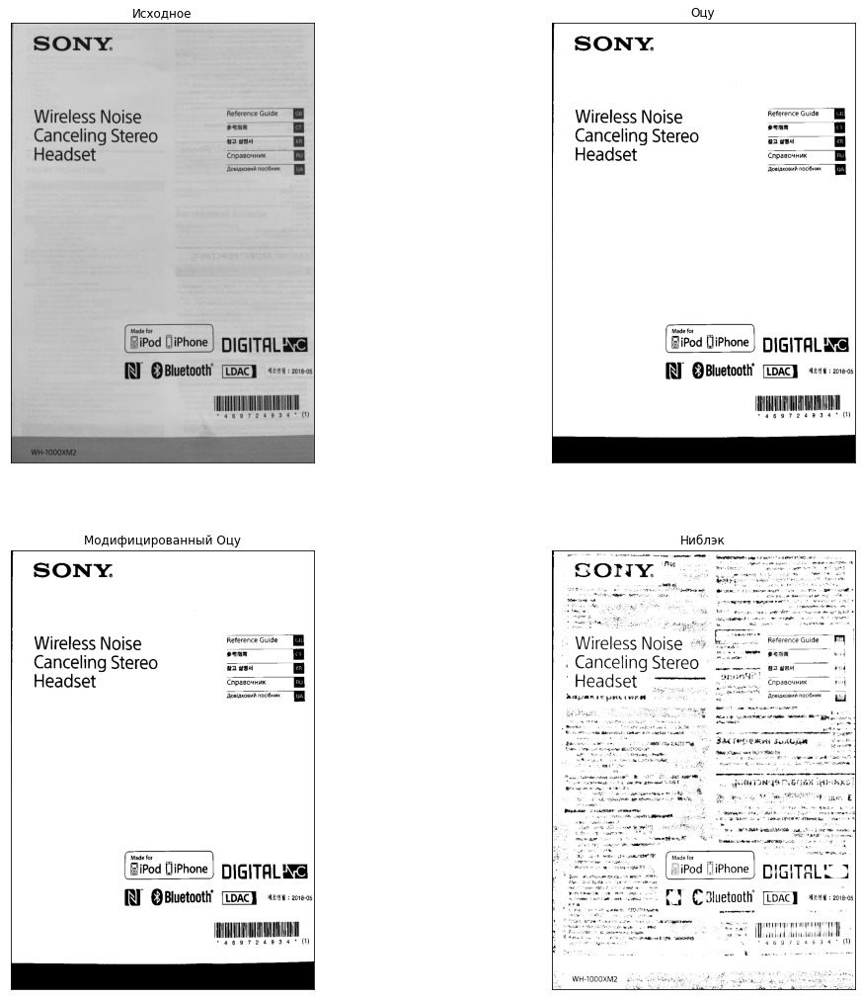

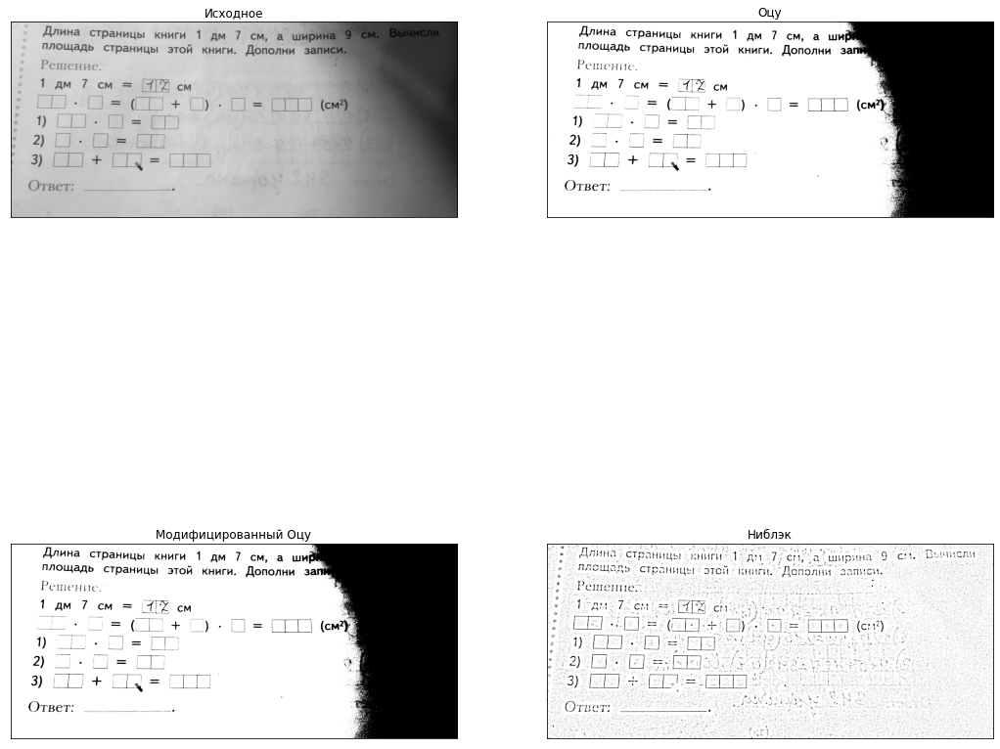

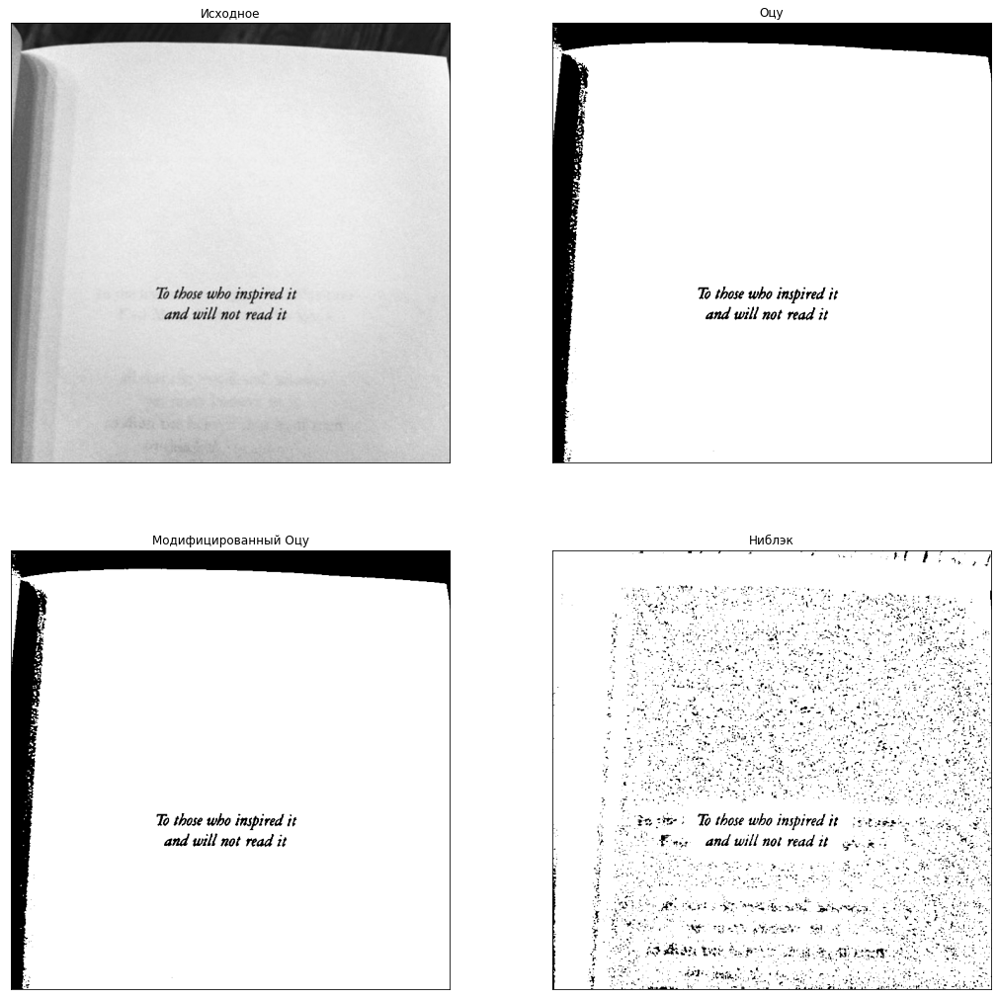

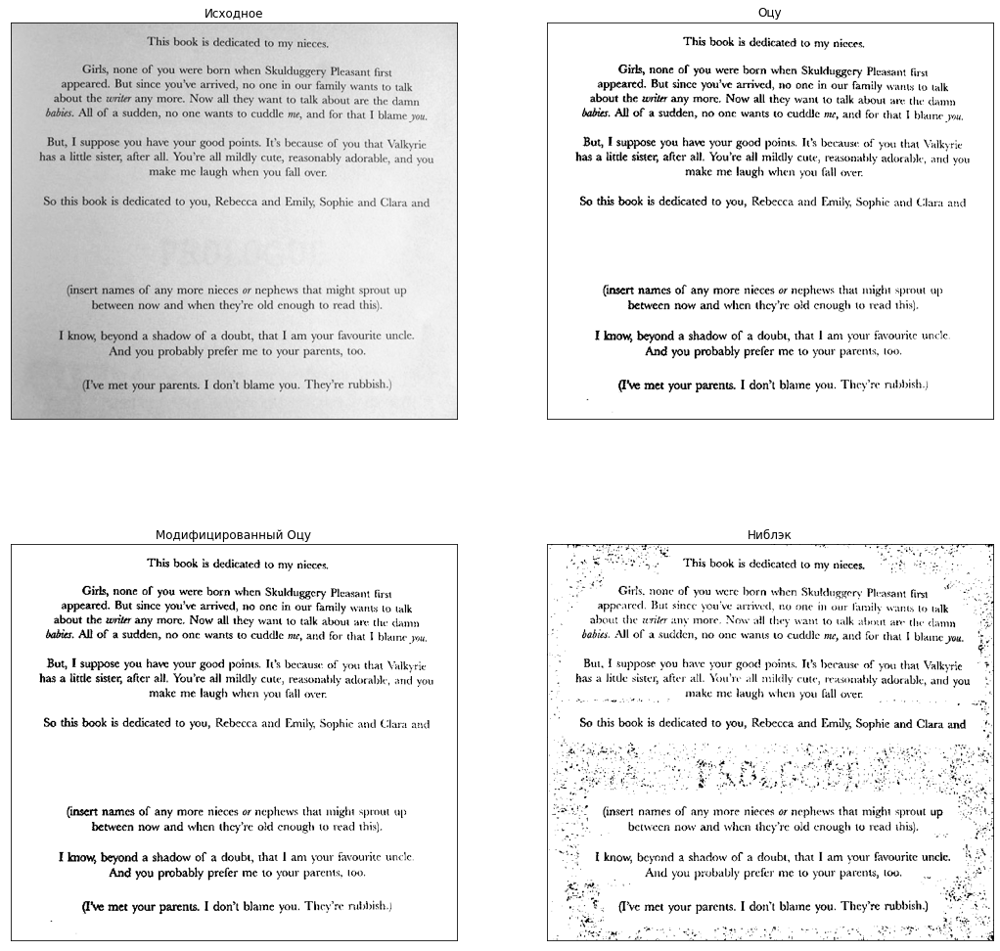

...

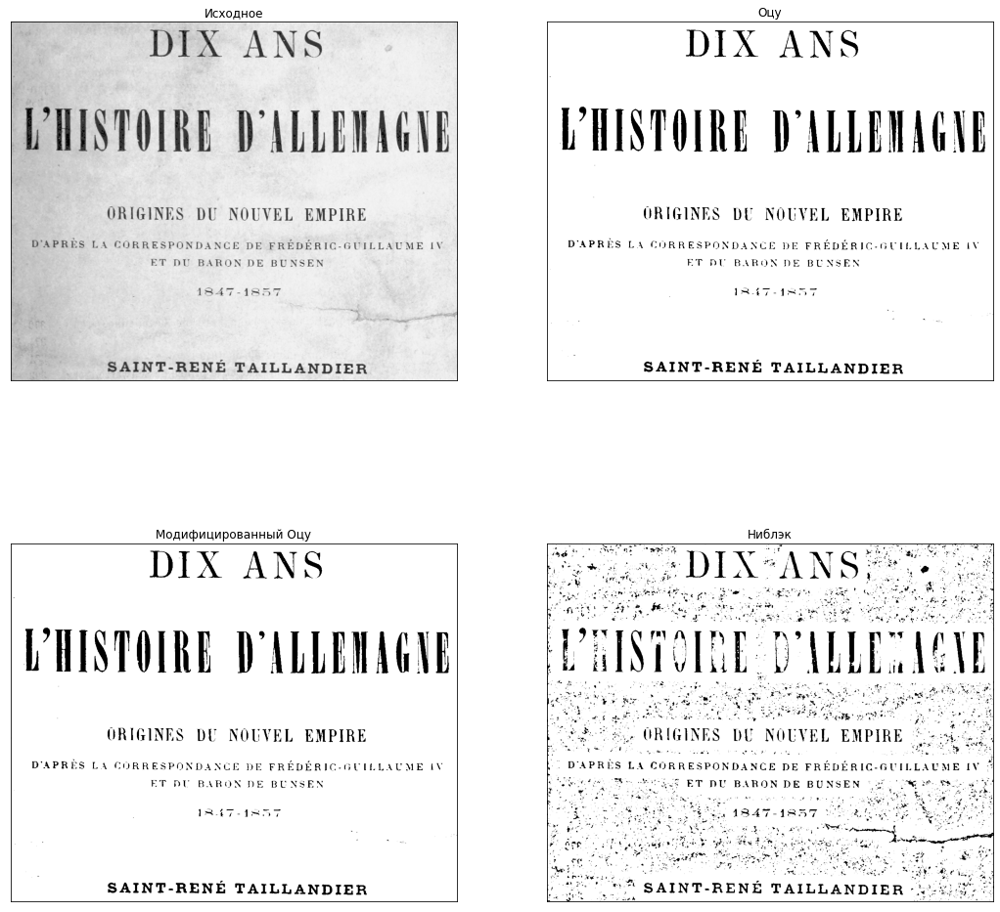

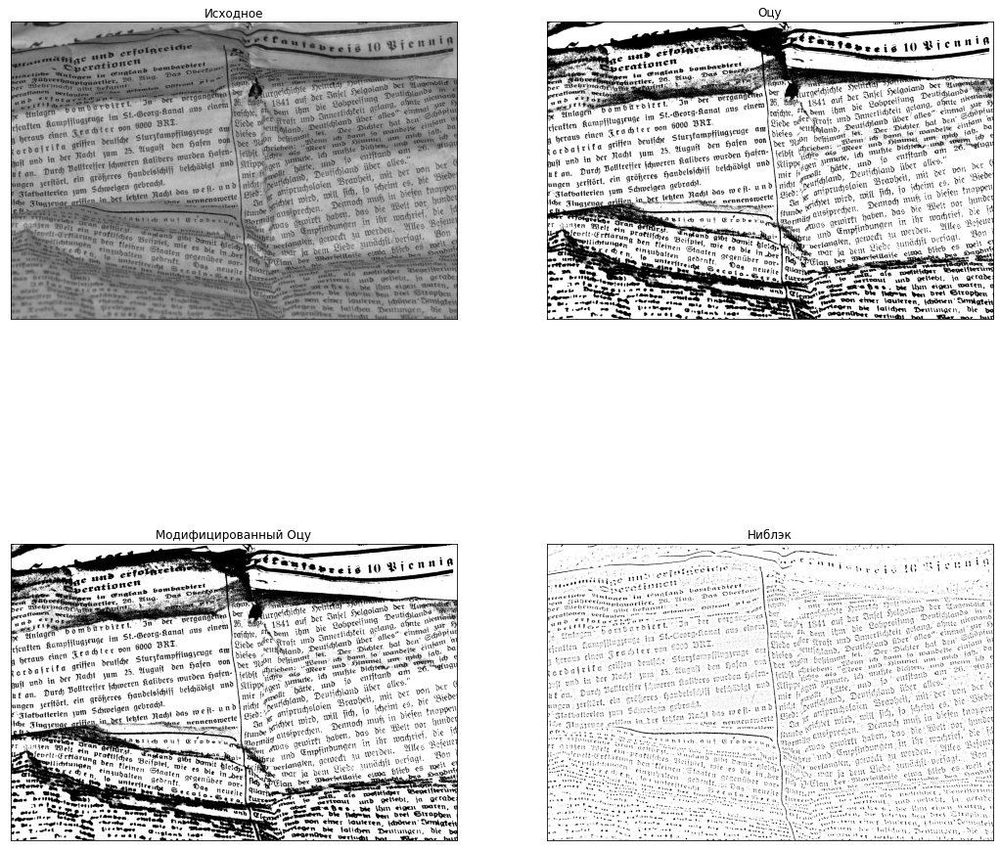

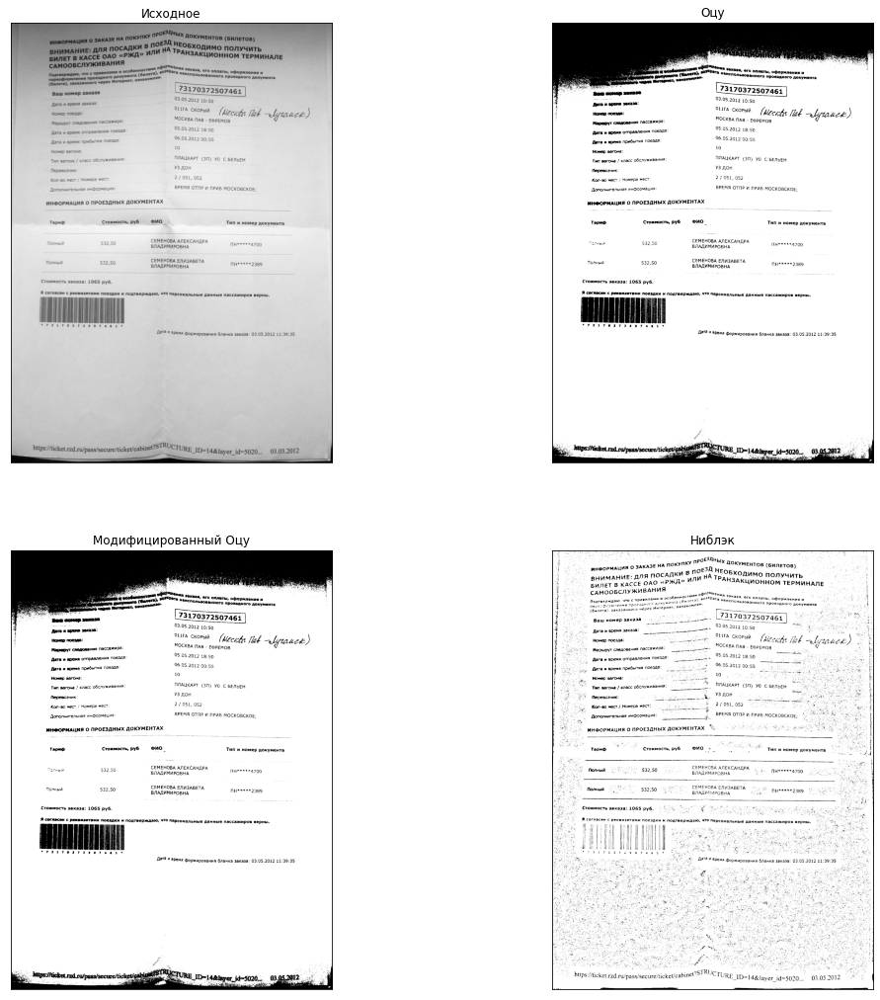

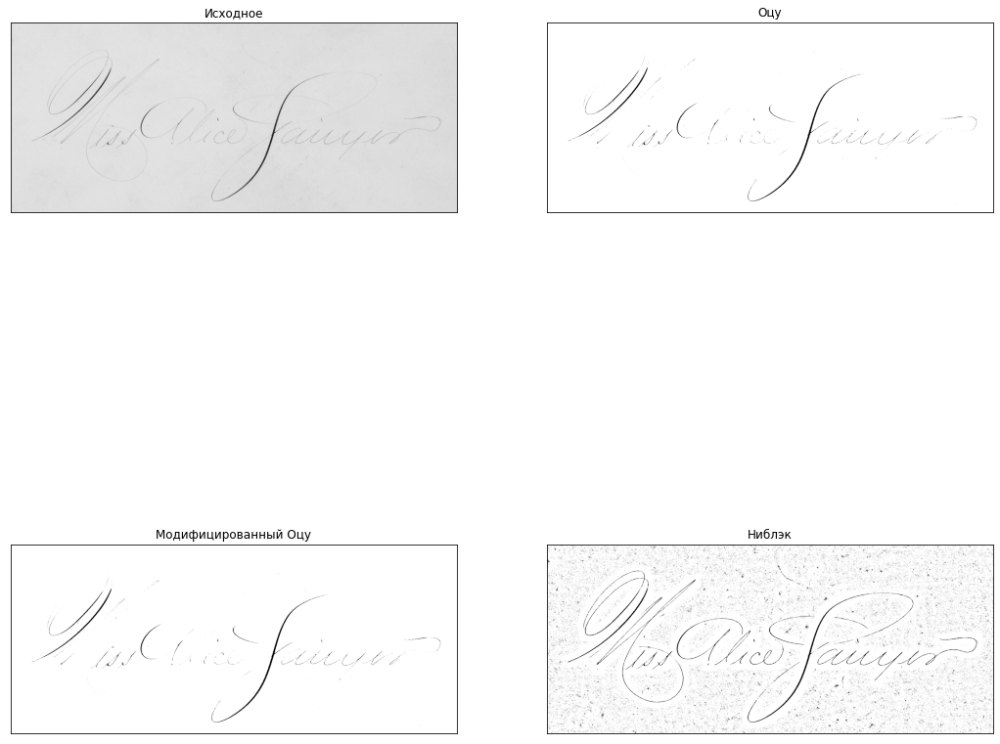

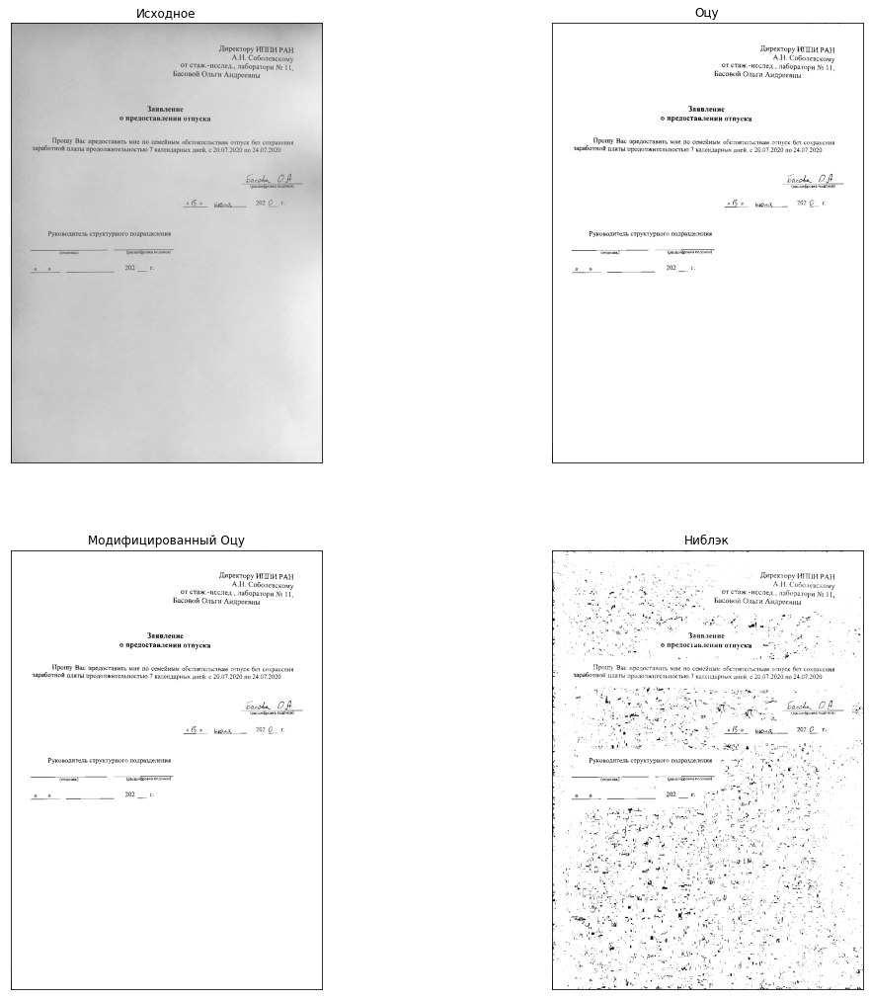

/var/folders/6g/12cxwdw12d9dgct102fx_9xm0000gn/T/ipykernel_9673/1458911020.py:7: RuntimeWarning: invalid value encountered in sqrt
  std = np.sqrt(cnv_avg_sq - cnv_avg ** 2)


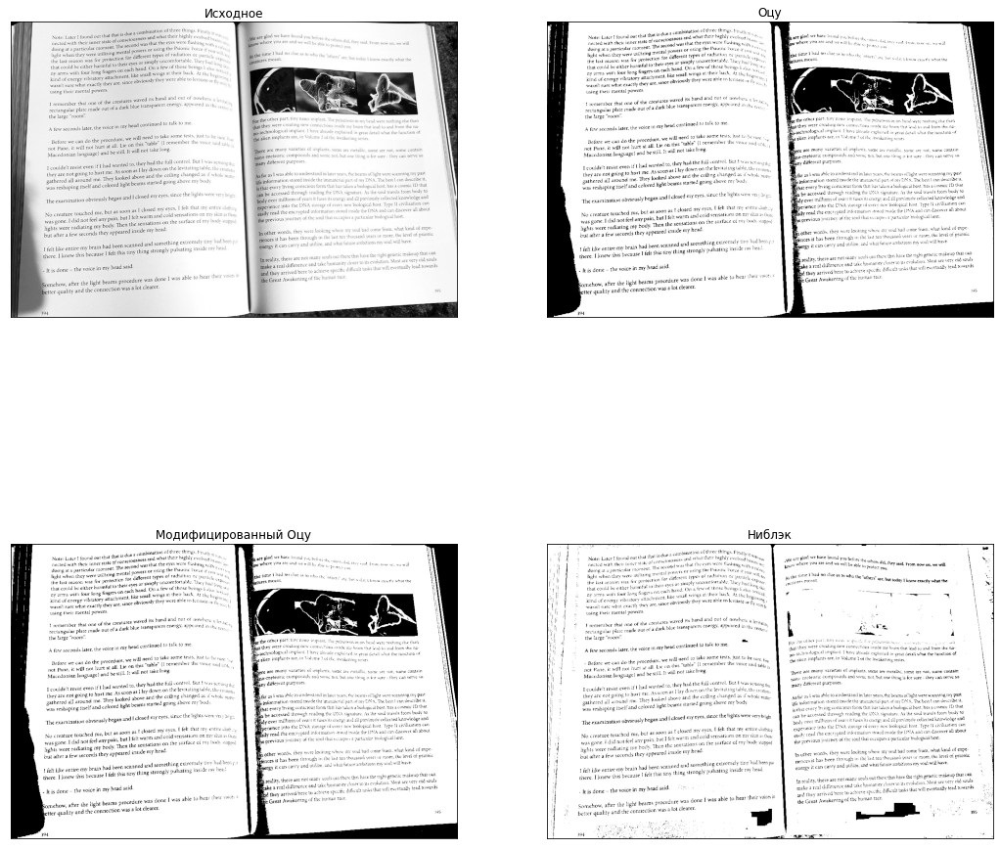

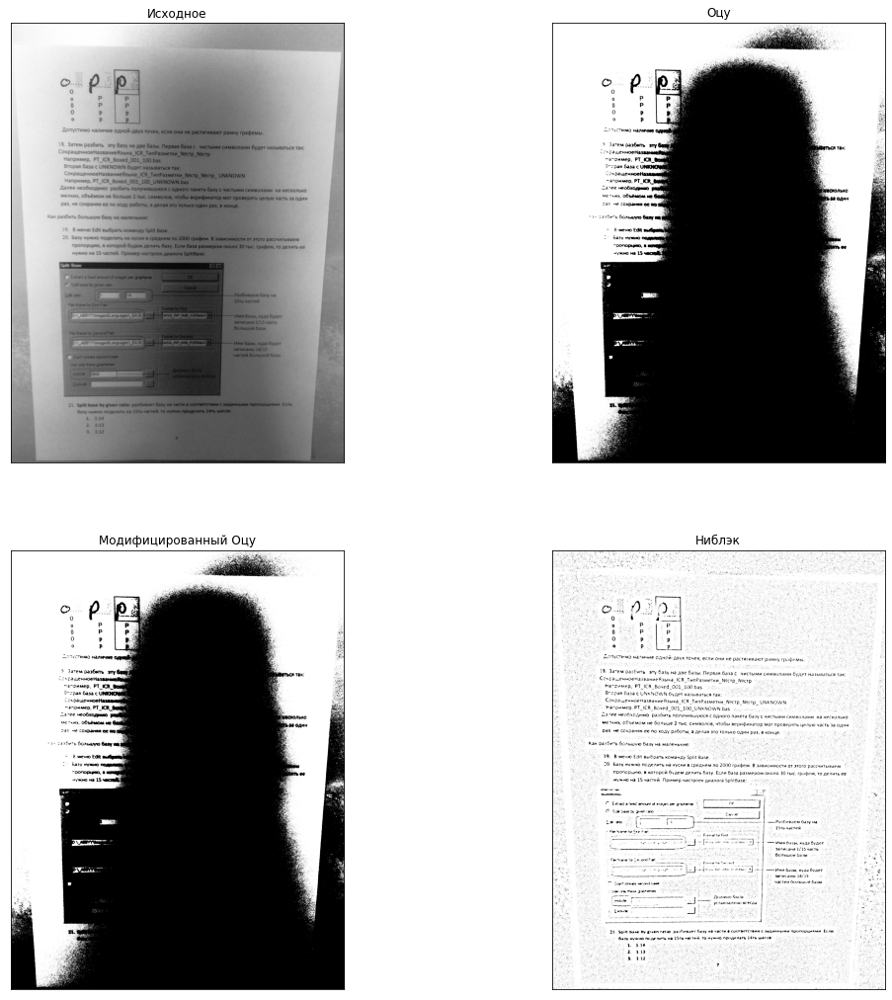

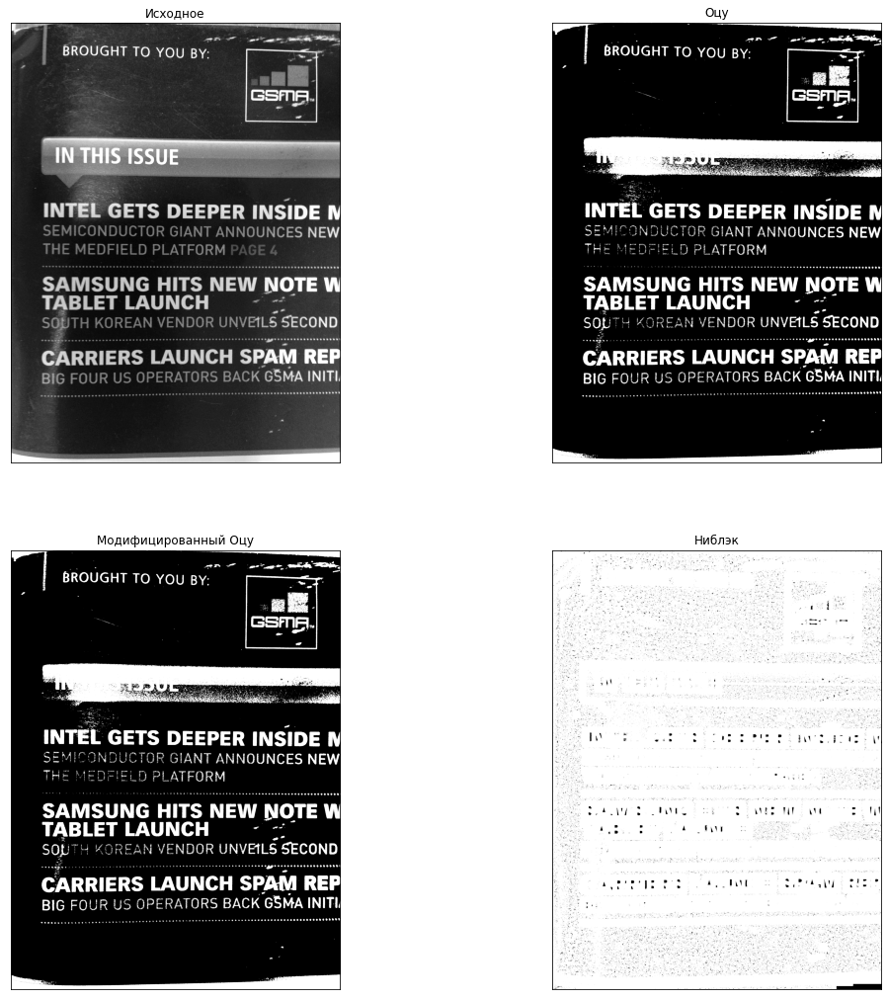

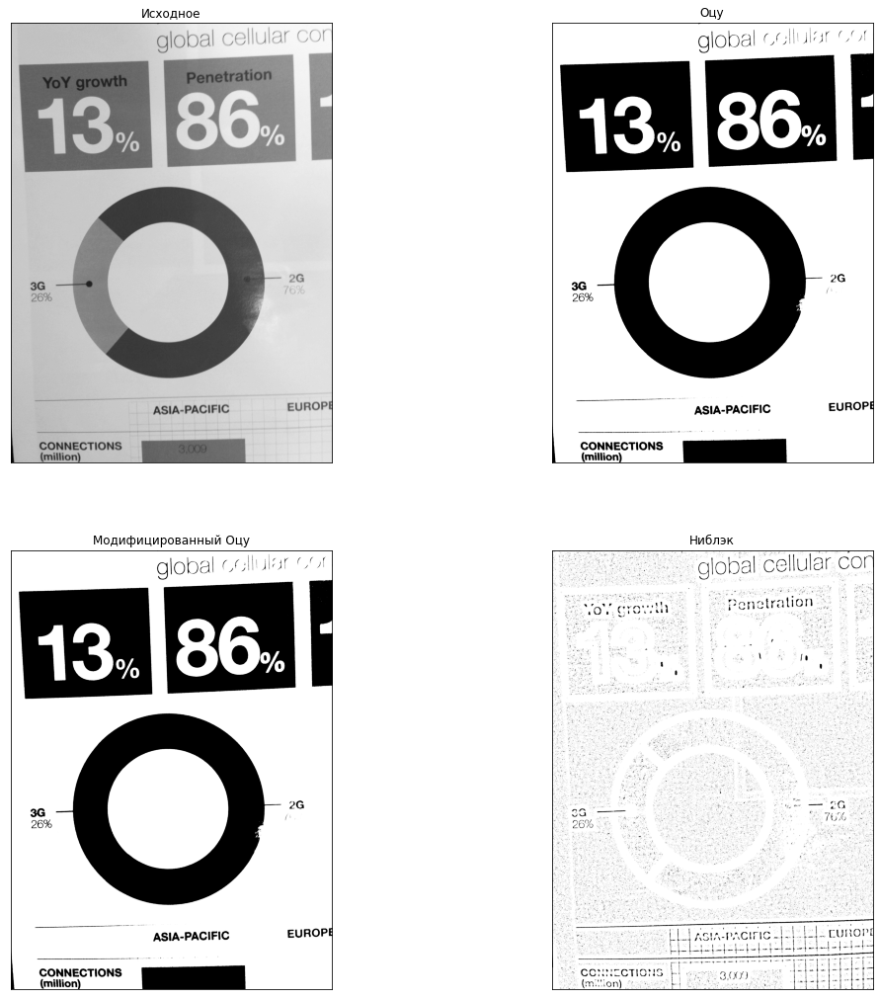

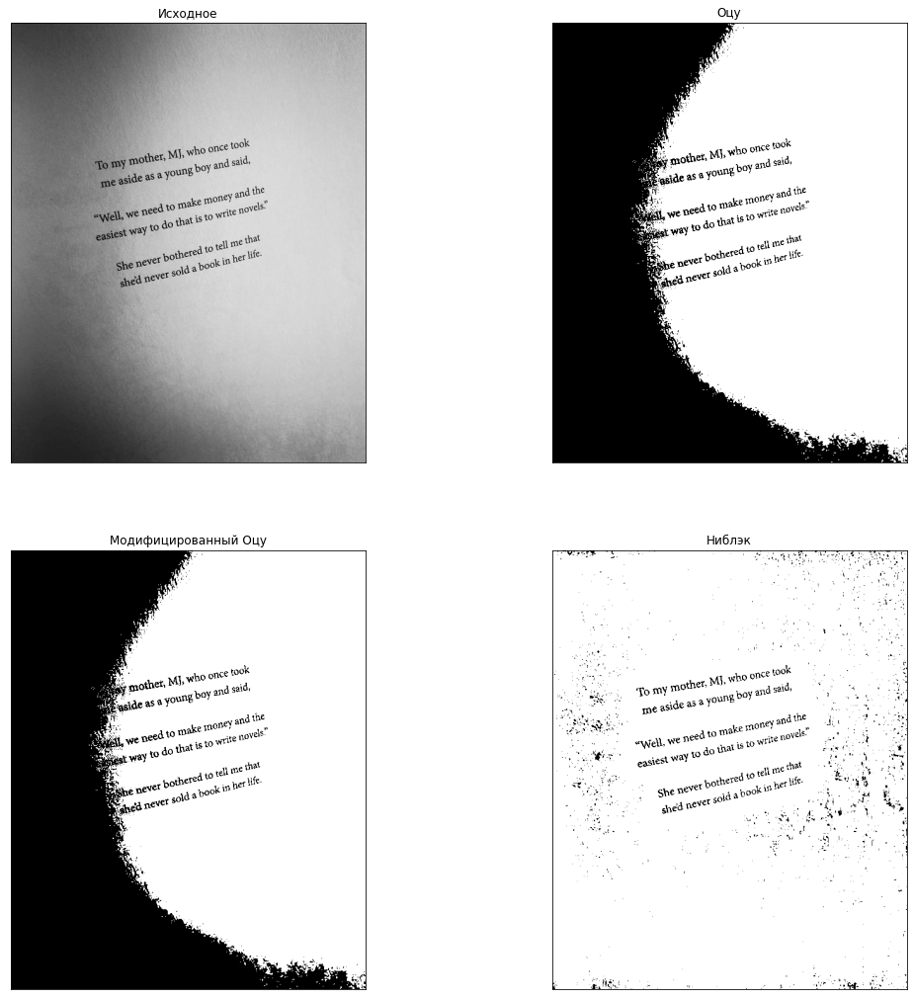

...

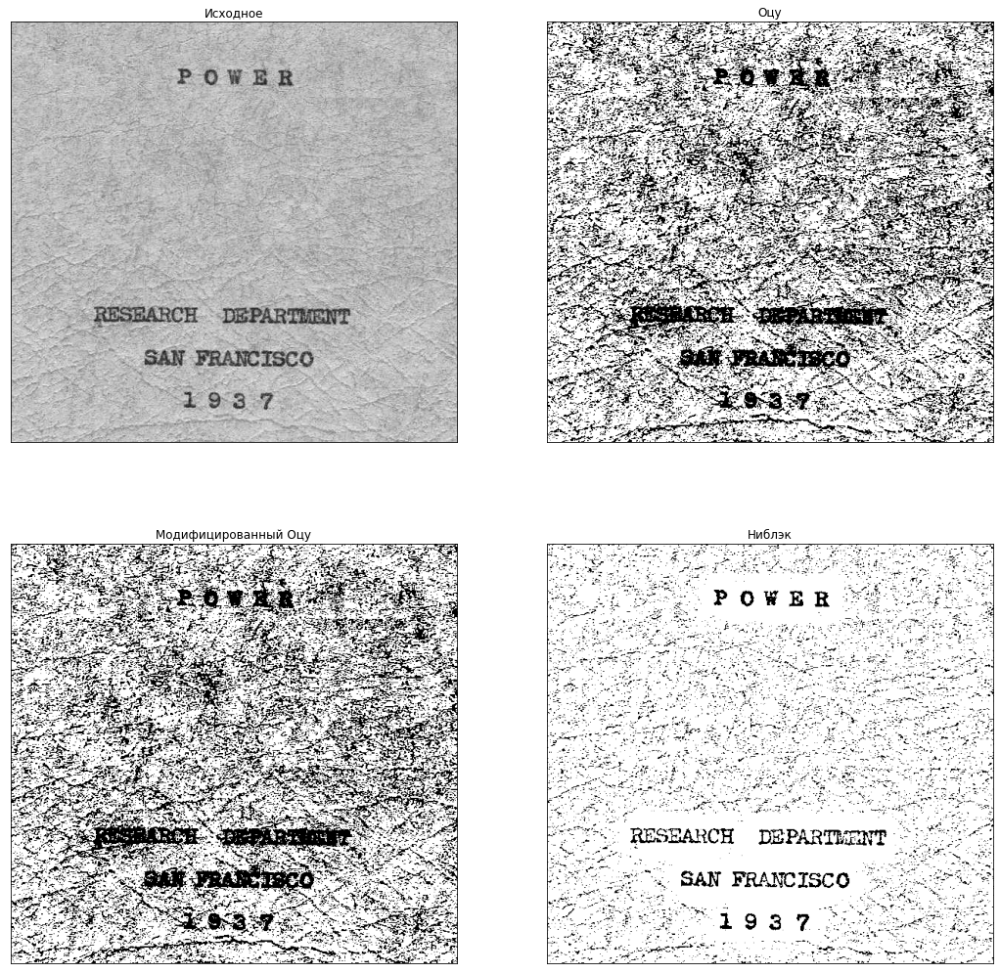

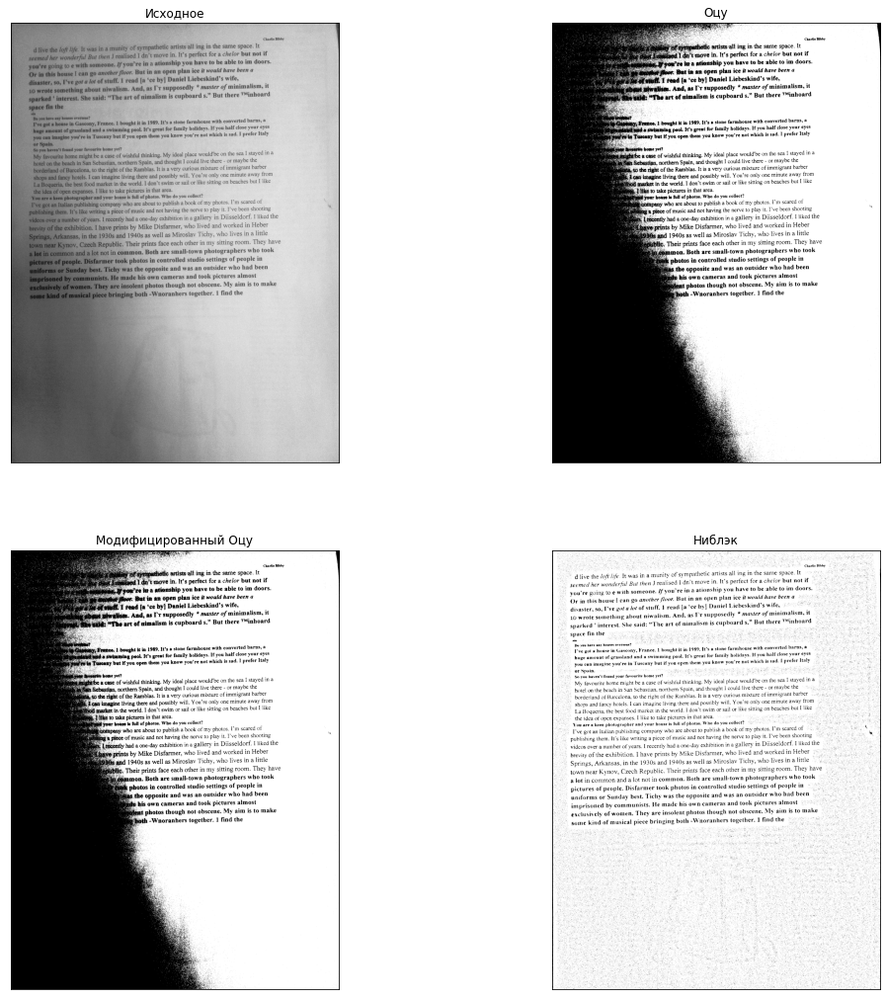

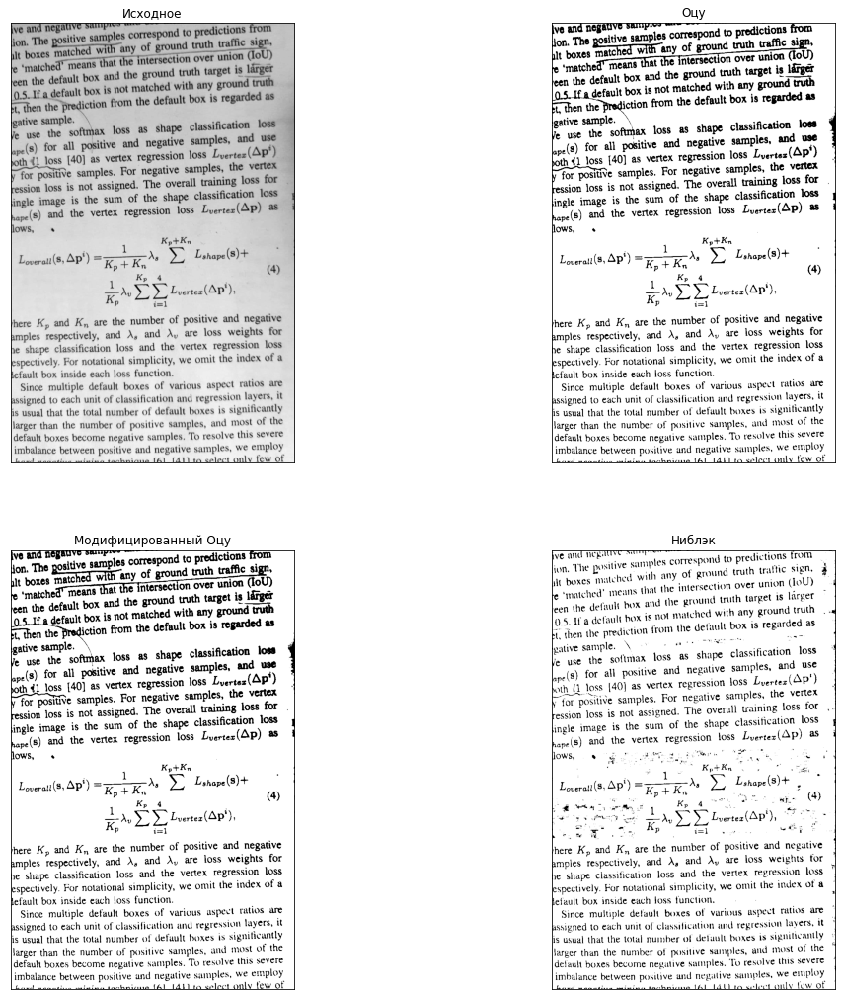

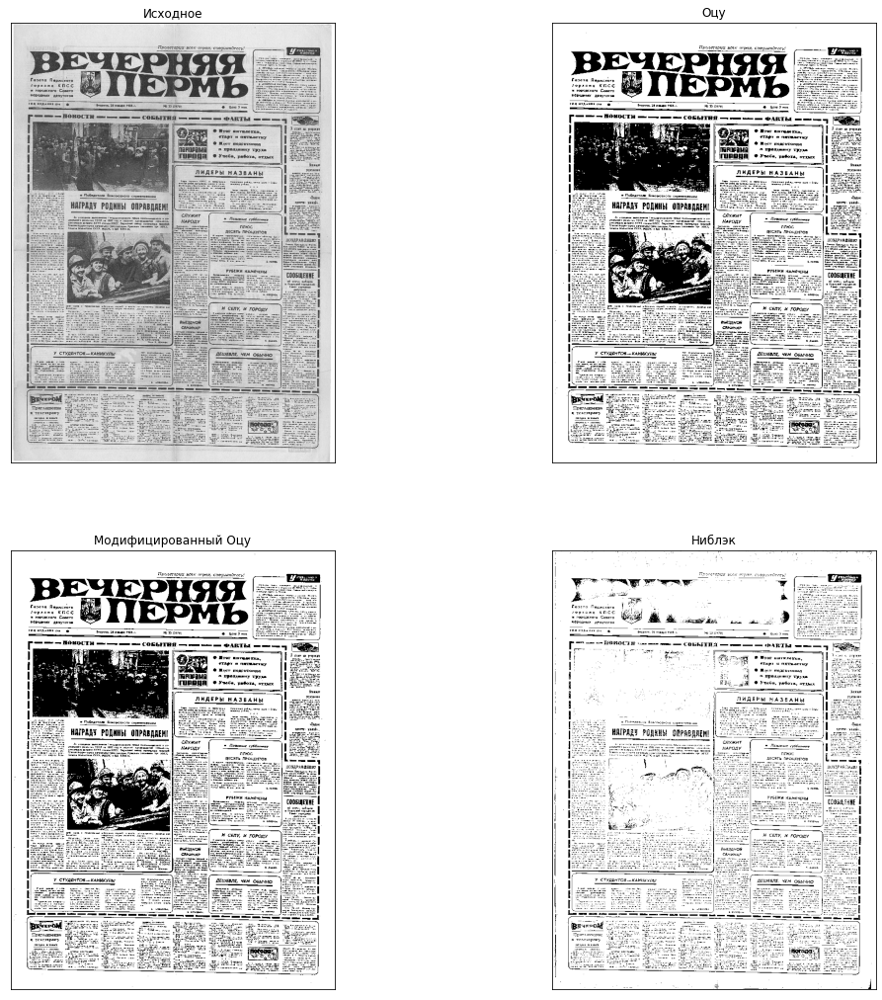

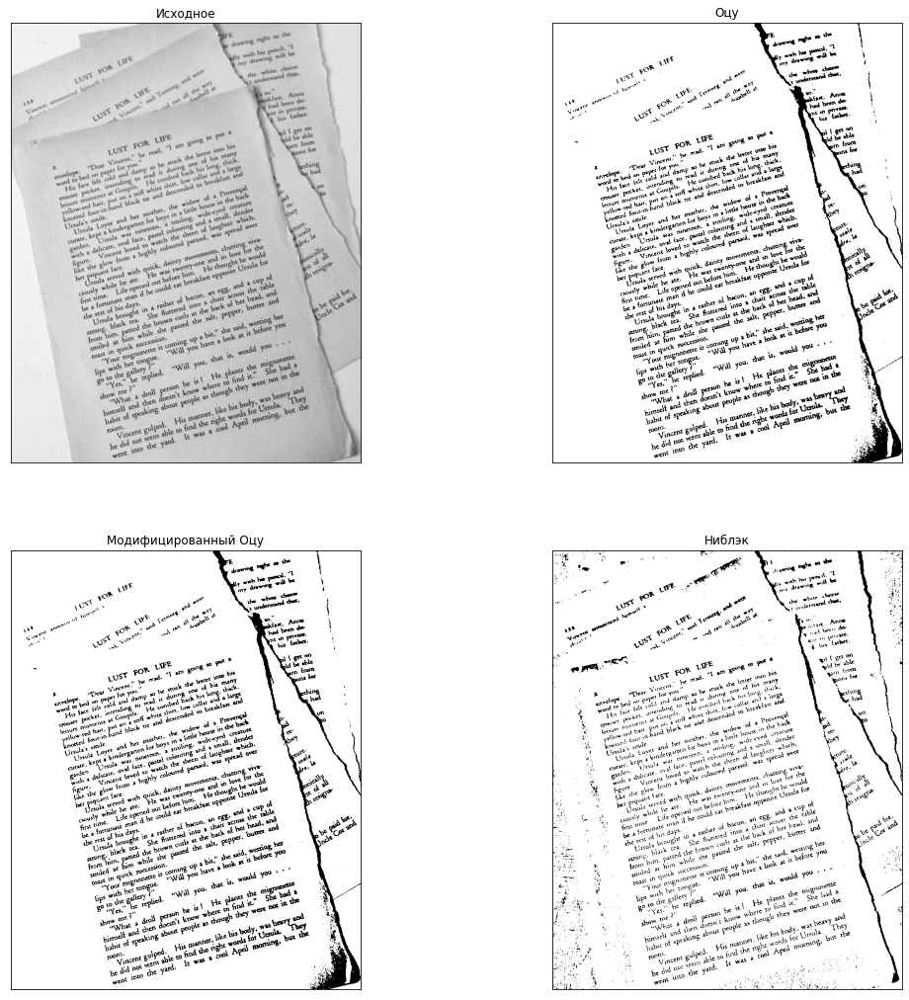

In [288]:
directory = 'dataset/'
image_list = []

for filename in os.listdir(directory):
    im = Image.open('dataset/' + filename)
    img = np.array(im.convert("L"))
    image_list.append(img)
    
for i in image_list:
    fig = plt.figure(figsize=(18,18))
    ax_source = fig.add_subplot(221, title='Исходное')
    ax_source.axes.xaxis.set_ticks([])
    ax_source.axes.yaxis.set_ticks([])
    ax_source.imshow(i, cmap='Greys_r')

    th_o, img_o = otsu(i)
    ax_otsu = fig.add_subplot(222, title='Оцу')
    ax_otsu.axes.xaxis.set_ticks([])
    ax_otsu.axes.yaxis.set_ticks([])    
    ax_otsu.imshow(img_o, cmap='Greys_r')

    th_o_mod, img_o_mod = otsu_modification(i)
    ax_otsu_mod = fig.add_subplot(223, title='Модифицированный Оцу')
    ax_otsu_mod.axes.xaxis.set_ticks([])
    ax_otsu_mod.axes.yaxis.set_ticks([])    
    ax_otsu_mod.imshow(img_o, cmap='Greys_r')

    img_nibl = niblack(i, 50, 1.3)
    ax_nibl = fig.add_subplot(224, title='Ниблэк')
    ax_nibl.axes.xaxis.set_ticks([])
    ax_nibl.axes.yaxis.set_ticks([]) 
    ax_nibl.imshow(img_nibl, cmap='Greys_r')
    plt.show()    
    print()